# Measures based upon test result values 
# North Devon and Cornwall


In [1]:
import pandas as pd
import numpy as np
from ebmdatalab import charts
from matplotlib import pyplot as plt

## Load the data

In [3]:
df = pd.read_csv("/Users/hcurtis/Documents/Python Scripts/openpathology/combined_labs/compiled_data_anonymised.csv")

# Convert month to datetime
df["month"] = pd.to_datetime(df["month"])

df.drop(["female_population", "male_population", "total_list_size"], axis=1).head()

,Unnamed: 0,Unnamed: 0.1,ccg_id,count,error,lab,month,practice_id,result_category,rural,test_code,urban,datalab_testcode
0,0,109727,11N,3,2.0,ND,2014-01-01,1,2,1.0,A1AT,0.0,A1AT
1,1,109783,11N,3,2.0,ND,2014-01-01,1,2,1.0,ACCP,0.0,ACCP
2,2,109830,11N,3,2.0,ND,2014-01-01,1,2,1.0,ADNA,0.0,ADNA
3,3,109948,11N,28,0.0,ND,2014-01-01,1,-1,1.0,ALB,0.0,ALB
4,4,109949,11N,572,0.0,ND,2014-01-01,1,0,1.0,ALB,0.0,ALB


# Proportion of tests outside range

Note we are excluding tests without known results or reference ranges applied. 

In [4]:
#filter for any tests with a valid result
df1 = df.copy()
df1 = df1.loc[df1["result_category"] <2]

# categorise values above/below/outside range
df1["above"] = 0
df1.loc[(df1["result_category"]==1), "above"] = 1

df1["below"] = 0
df1.loc[(df1["result_category"]==-1), "below"] = 1

df1["outside"] = 0
df1.loc[(df1["result_category"]==1) | (df1["result_category"]==-1), "outside"] = 1

df1.drop(["female_population", "male_population", "total_list_size"], axis=1).head()

,Unnamed: 0,Unnamed: 0.1,ccg_id,count,error,lab,month,practice_id,result_category,rural,test_code,urban,datalab_testcode,above,below,outside
3,3,109948,11N,28,0.0,ND,2014-01-01,1,-1,1.0,ALB,0.0,ALB,0,1,1
4,4,109949,11N,572,0.0,ND,2014-01-01,1,0,1.0,ALB,0.0,ALB,0,0,0
5,5,109950,11N,6,0.0,ND,2014-01-01,1,1,1.0,ALB,0.0,ALB,1,0,1
8,8,110257,11N,3,2.0,ND,2014-01-01,1,-1,1.0,ALKP,0.0,ALKP,0,1,1
9,9,110258,11N,529,0.0,ND,2014-01-01,1,0,1.0,ALKP,0.0,ALKP,0,0,0


##  Compare proportion outside range between labs

In [8]:
counts = df1.groupby(["datalab_testcode", "lab", "result_category"]).agg({"count":"sum","error":"sum"}).unstack().fillna(0).reset_index()

counts["total"] = (counts[("count",0)]+counts[("count",1)]+counts[("count",-1)])
counts = counts.loc[counts["total"]>500].drop("error",axis=1)

counts["percent_above"] = (100*counts[("count",1)]/(counts[("count",0)]+counts[("count",1)]+counts[("count",-1)])).astype(int)
counts["percent_below"] = (100*counts[("count",-1)]/(counts[("count",0)]+counts[("count",1)]+counts[("count",-1)])).astype(int)

counts.columns = [(x + '_' + str(i)).rstrip('_') for x, i in zip(counts.columns.get_level_values(0), counts.columns.get_level_values(1))]

counts = counts.set_index(["datalab_testcode","lab"]).unstack().reset_index().sort_values(by=[("percent_above","RC"),("percent_above","ND")])

counts["above_diff"] = abs(counts[("percent_above","RC")] - counts[("percent_above","ND")])
counts["below_diff"] = abs(counts[("percent_below","RC")] - counts[("percent_below","ND")])

counts.sort_values(by="above_diff", ascending=False)

C:\Users\hcurtis\Anaconda3\lib\site-packages\pandas\core\generic.py:3812: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  new_axis = axis.drop(labels, errors=errors)


datalab_testcode  count_-1             count_0              count_1  \
lab                         ND        RC        ND         RC        ND   
10              BASO   11028.0   29348.0  433419.0        0.0    1293.0   
58              MONO    1305.0  149992.0  428192.0        0.0   16490.0   
21               EOS   13778.0  142005.0  395300.0        0.0   36008.0   
53              LYMP   36028.0  144114.0  394436.0   426464.0   14925.0   
65                PT    3024.0    3149.0    1957.0    37077.0    2404.0   
22               ESR       0.0     816.0     513.0   196540.0     651.0   
34               GLU    1173.0      21.0   13755.0     2148.0   10936.0   
8                AST       0.0      27.0    2001.0     7650.0     687.0   
7               APTT    1986.0    1053.0       0.0    29787.0       0.0   
49               LDH     120.0       9.0    3247.0     1194.0    1050.0   
56               MCV   14502.0   10643.0  403812.0  1134040.0   27160.0   
51                LH     108.0     342.0     750.0     3009.0     255.0   
64              PRL3     393.0    1341.0    3297.0    10747.0    2192.0   
41               HCT   92516.0  183743.0  343540.0  1062047.0    9548.0   
32               GGT       0.0    2189.0    4687.0    30405.0    5274.0   
54               MCH   34222.0  123900.0  335453.0  1201714.0   75905.0   
62              PHOS    1167.0   11320.0   13002.0   337455.0    2014.0   
81              UREA    1538.0    1911.0   84757.0    59211.0   23338.0   
61              OSMO     297.0     708.0     354.0      867.0      63.0   
27               FOL    8888.0   20223.0   50547.0   192440.0    6028.0   
77                UA     306.0    1266.0    6925.0    27850.0    5288.0   
66               PTH     228.0     573.0    2953.0     8457.0    3871.0   
16                CK     246.0    1797.0    5056.0    31337.0    1270.0   
76               TSH   10028.0   40427.0  159623.0   617950.0   26044.0   
5                AMY       0.0     306.0    8256.0     7675.0    1358.0   
18              CREA   12295.0   66677.0  400690.0  1219700.0  121236.0   
82            VITB12    3675.0   13812.0   54864.0   215869.0    7420.0   
70             RETIC     501.0      60.0    2221.0     4149.0    1182.0   
68               RBC  109650.0  261070.0  335553.0  1110316.0     975.0   
25               FER    8699.0   19316.0   70098.0   261254.0   14476.0   
..               ...       ...       ...       ...        ...       ...   
43               IGA       NaN    4192.0       NaN    47165.0       NaN   
45               IGM       NaN    4231.0       NaN    40499.0       NaN   
26               FIB       NaN     120.0       NaN     1540.0       NaN   
44               IGG       NaN    2784.0       NaN    41619.0       NaN   
50               LDL       NaN   64055.0       NaN   519987.0       NaN   
72              SHBG       NaN     978.0       NaN     8212.0       NaN   
42               HDL       NaN   32954.0       NaN   540155.0       NaN   
0                ACE       NaN      24.0       NaN      657.0       NaN   
6               APTR       NaN     117.0       NaN    29649.0       NaN   
73              TEST       NaN    4888.0       NaN    12864.0       NaN   
59              NEUT       NaN  286147.0       NaN   856259.0       NaN   
47              IRO2       NaN    1976.0       NaN     7011.0       NaN   
30               FT4       NaN    4486.0       NaN    76390.0       NaN   
35              H1CF       NaN     333.0       NaN   178676.0       NaN   
29               FT3       NaN     183.0       NaN     3527.0       NaN   
46               INR       NaN      36.0       NaN    39200.0       NaN   
79               UNA     402.0       NaN     327.0        NaN       3.0   
38               HBF       0.0       NaN    1266.0        NaN      48.0   
37              HBA2      51.0       NaN    1245.0        NaN      60.0   
39               HCG       0.0       NaN     576.0        NaN      57.0   
4                ALT       0.

## Tests with above and below-range options
- we want to look at proportion above and below as separate measures to see seasonality or other interesting patterns

- tests of interest: 
  - Potassium (K) (spurious seasonality of results caused by temperature-dependent membrane diffusion of potassium if samples are not spun prior to transport) 
  - TSH, 
  - HB (there is reportedly true seasonality in high and low HB levels in population - lower in warmer months)

## Plot proportion above and below range separately for each lab - deciles and mean


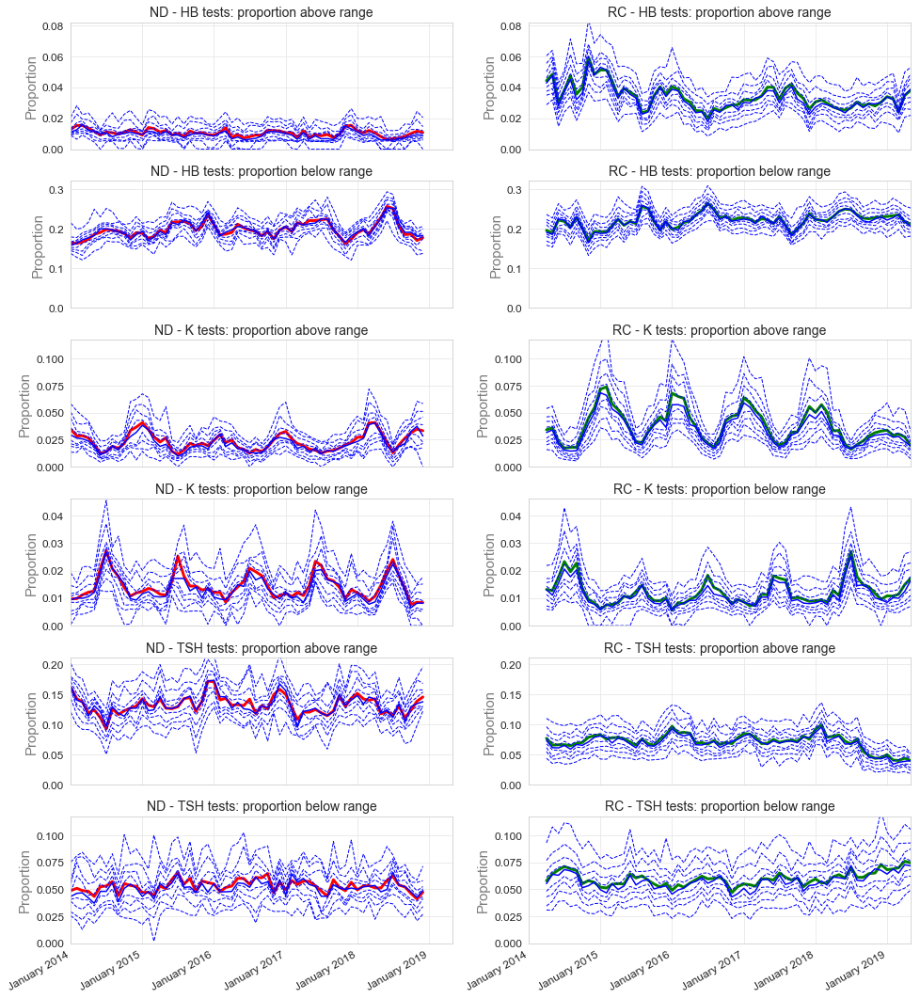

In [10]:
testcode=["K","TSH","HB"]
min_tests_pm = 10

# filter for test of interest:
data = df1.copy().loc[df1["datalab_testcode"].isin(testcode)]
    
# group and rearrange data
data = data.groupby(["month", "lab", "practice_id", "datalab_testcode","result_category"]).agg({"count":"sum","error":"sum"}).unstack().fillna(0).reset_index()
# calculate proportions
data["proportion_above"] = data[("count",1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])
data["proportion_below"] = data[("count",-1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])
data["proportion_above_error"] = data[("error",1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])
data["proportion_below_error"] = data[("error",-1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])

# remove very low test volumes
data = data.loc[data[("count",0)]>min_tests_pm]

# rearrange to put measures in columns
data.columns = [(x + '_' + str(i)).rstrip('_') for x, i in zip(data.columns.get_level_values(0), data.columns.get_level_values(1))]
data = data.drop(["count_0","error_0","count_1","error_1","count_-1","error_-1"], axis=1)
data = data.set_index(["month","lab","practice_id","datalab_testcode"]).stack().reset_index().rename(columns={"level_4":"measure",0:"measure_value"})
  
# find mean values    
means = data.copy()
means = means.groupby(["month","lab","datalab_testcode","measure"]).mean().reset_index()    

# count number of practices in order to set the required number of subplots
no_figs = np.int(data.datalab_testcode.nunique())*2

    
fig, axs = plt.subplots(no_figs, 2, figsize = (16,20), facecolor='w')
fig.subplots_adjust(hspace = .25, wspace=.2)

# using a generator, create a combination of each each measure and each lab (like a cross-product)
# this will set the sequence of figures to plot
a = data["datalab_testcode"].unique() # don't count error values separately
b = data["measure"].str.replace("_error","").unique() # don't count error values separately
gen = ((test, measure, lab) for test in a for measure in b for lab in ["ND","RC"] )
# this will let us plot practice 1, measure 1 alongside practice 1, measure 2  and so on

for ax, (test, measure, lab) in zip(axs.ravel(), gen):
    ax.set_title(str(lab)+" - "+test+" tests: "+measure.replace("_"," ")+" range", size=14)
    fig_no = ax.get_geometry()[2]
    if fig_no % 2 == 0:
        color = "g"
    else:
        color = "r"
    # select and plot means
    meandata = means.loc[(means["datalab_testcode"]==test) & (means["measure"]==measure) & (means["lab"]==lab)]
    ax.plot(meandata['month'], meandata["measure_value"], color=color, linewidth=3)
    # plot deciles onto every subplot:
    charts.deciles_chart(
        data.loc[(data["datalab_testcode"]==test) & (data["measure"]==measure) & (data["lab"]==lab)],
        period_column='month',
        column="measure_value",
        ylabel="Proportion",
        show_legend=False,
        show_outer_percentiles=False,
        ax=ax)
    ax.set_ylim(0,data[(data["measure"]==measure) &(data["datalab_testcode"]==test)].groupby("month")["measure_value"].quantile(0.9).max()*1.05)
    ax.set_xlim(data["month"].min(),data["month"].max())
    
plt.show()

## Proportion above and below range - lab medians and IQRs

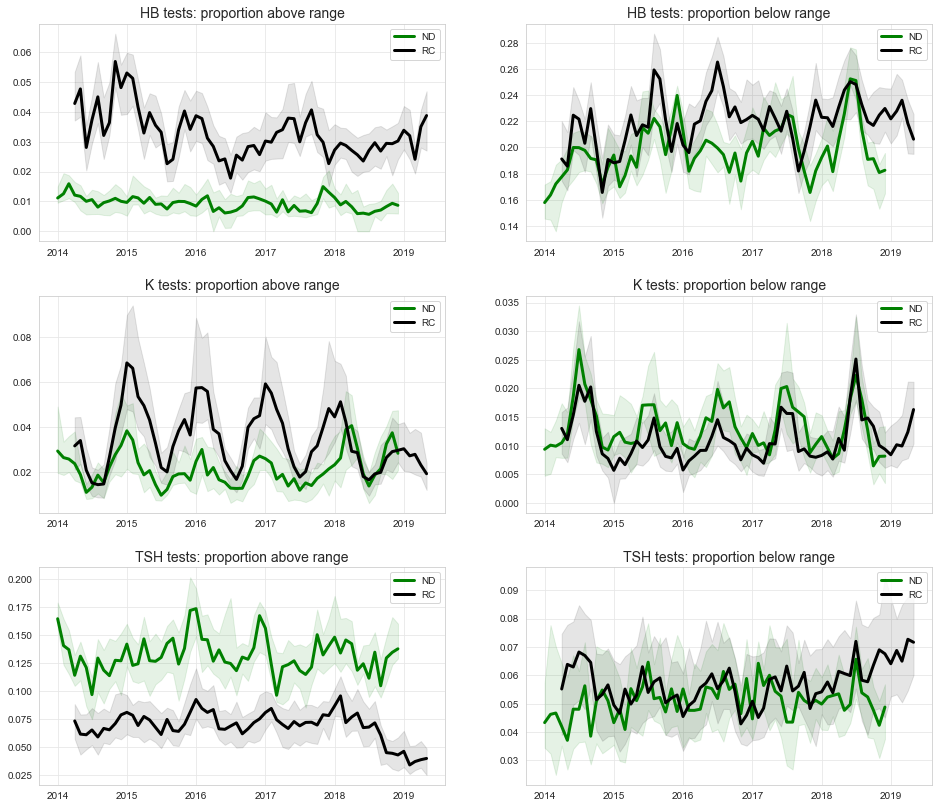

In [11]:
testcode=["K","TSH","HB"]
min_tests_pm = 10

# filter for test of interest:
data = df1.copy().loc[df1["datalab_testcode"].isin(testcode)]
    
# group and rearrange data
data = data.groupby(["month", "lab", "practice_id", "datalab_testcode","result_category"]).agg({"count":"sum","error":"sum"}).unstack().fillna(0).reset_index()

# remove very low test volumes
data.loc[data[("count",0)]<min_tests_pm, ("count",0)] = np.NaN

# calculate proportions
data["proportion_above"] = data[("count",1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])
data["proportion_below"] = data[("count",-1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])
data["proportion_above_error"] = data[("error",1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])
data["proportion_below_error"] = data[("error",-1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])



# rearrange to put measures in columns
data.columns = [(x + '_' + str(i)).rstrip('_') for x, i in zip(data.columns.get_level_values(0), data.columns.get_level_values(1))]
data = data.drop(["count_0","error_0","count_1","error_1","count_-1","error_-1"], axis=1)
data = data.set_index(["month","lab","practice_id","datalab_testcode"]).stack().reset_index().rename(columns={"level_4":"measure",0:"measure_value"})
  
# count number of tests in order to set the required number of subplots
no_figs = np.int(data.datalab_testcode.nunique())

    
fig, axs = plt.subplots(no_figs, 2, figsize = (16,14), facecolor='w')
fig.subplots_adjust(hspace = .25, wspace=.2)

# using a generator, create a combination of each each measure and each lab (like a cross-product)
# this will set the sequence of figures to plot
a = data["datalab_testcode"].unique() # don't count error values separately
b = data["measure"].str.replace("_error","").unique() # don't count error values separately
gen = ((test, measure) for test in a for measure in b)
# this will let us plot practice 1, measure 1 alongside practice 1, measure 2  and so on

for ax, (test, measure) in zip(axs.ravel(), gen):
    
    # select and plot means
    for lab, c in zip(["ND","RC"],["g","k"]):
        
        median = data.loc[(data["datalab_testcode"]==test) & (data["measure"]==measure) & (data["lab"]==lab)].groupby("month").quantile(0.5).reset_index()
        ax.plot(median['month'], median["measure_value"], color=c, linewidth=3, label=lab)
        # error bars
        upper = data.loc[(data["datalab_testcode"]==test) & (data["measure"]==measure) & (data["lab"]==lab)].groupby("month").quantile(0.75).reset_index()
        lower = data.loc[(data["datalab_testcode"]==test) & (data["measure"]==measure) & (data["lab"]==lab)].groupby("month").quantile(0.25).reset_index()
        ax.fill_between(lower['month'], lower["measure_value"], upper["measure_value"], color=c, alpha=0.1)
    #ax.set_ylim(0,data[(data["measure"]==measure) &(data["datalab_testcode"]==test)].groupby("month")["measure_value"].quantile(0.9).max()*1.05)
    ax.set_title(test+" tests: "+measure.replace("_"," ")+" range", size=14)
    ax.legend()
    
plt.show()

## Tests out of range per 10k population - lab deciles and mean

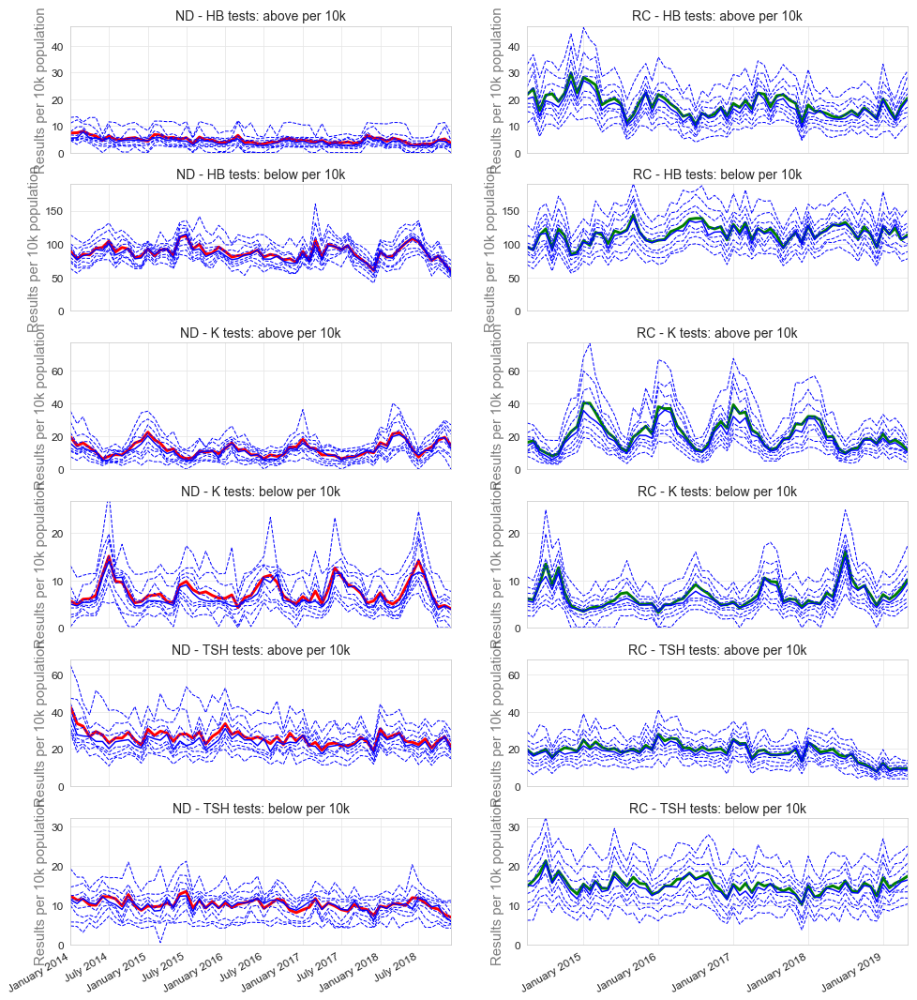

In [12]:
testcode=["K","TSH","HB"]
min_tests_pm = 10

# filter for test of interest:
data = df1.copy().loc[df1["datalab_testcode"].isin(testcode)]
    
# group and rearrange data
data = data.groupby(["month", "lab", "practice_id", "total_list_size", "datalab_testcode","result_category"]).agg({"count":"sum","error":"sum"}).unstack().fillna(0).reset_index()
# calculate proportions

data["above_per_10k"] = 10000*data[("count",1)]/(data["total_list_size"])
data["below_per_10k"] = 10000*data[("count",-1)]/(data["total_list_size"])
data["above_per_10k_error"] = 10000*data[("error",1)]/(data["total_list_size"])
data["below_per_10k_error"] = 10000*data[("error",-1)]/(data["total_list_size"])

# remove very low test volumes
data = data.loc[data[("count",0)]>min_tests_pm]

# rearrange to put measures in columns
data.columns = [(x + '_' + str(i)).rstrip('_') for x, i in zip(data.columns.get_level_values(0), data.columns.get_level_values(1))]
data = data.drop(["count_0","error_0","count_1","error_1","count_-1","error_-1","total_list_size"], axis=1)
data = data.set_index(["month","lab","practice_id","datalab_testcode"]).stack().reset_index().rename(columns={"level_4":"measure",0:"measure_value"})

# find mean values    
means = data.copy()
means = means.groupby(["month","lab","datalab_testcode","measure"]).mean().reset_index()    

# count number of practices in order to set the required number of subplots
no_figs = np.int(data.datalab_testcode.nunique())*2

    
fig, axs = plt.subplots(no_figs, 2, figsize = (16,20), facecolor='w')
fig.subplots_adjust(hspace = .25, wspace=.2)

# using a generator, create a combination of each each measure and each lab (like a cross-product)
# this will set the sequence of figures to plot
a = data["datalab_testcode"].unique() # don't count error values separately
b = data["measure"].str.replace("_error","").unique() # don't count error values separately
gen = ((test, measure, lab) for test in a for measure in b for lab in ["ND","RC"] )
# this will let us plot practice 1, measure 1 alongside practice 1, measure 2  and so on
 
for ax, (test, measure, lab) in zip(axs.ravel(), gen):
    ax.set_title(str(lab)+" - "+test+" tests: "+measure.replace("_"," "), size=14)
    fig_no = ax.get_geometry()[2]
    if fig_no % 2 == 0:
        color = "g"
    else:
        color = "r"
    # select and plot means
    meandata = means.loc[(means["datalab_testcode"]==test) & (means["measure"]==measure) & (means["lab"]==lab)]
    ax.plot(meandata['month'], meandata["measure_value"], color=color, linewidth=3)
     # plot deciles onto every subplot:
    charts.deciles_chart(
        data.loc[(data["datalab_testcode"]==test) & (data["measure"]==measure) & (data["lab"]==lab)],
        period_column='month',
        column="measure_value",
        ylabel="Results per 10k population",
        show_legend=False,
        show_outer_percentiles=False,
        ax=ax)
    ax.set_ylim(0,data[(data["measure"]==measure) &(data["datalab_testcode"]==test)].groupby("month")["measure_value"].quantile(0.9).max()*1.05)

plt.show()


# Plot data for each practice against deciles

In [20]:
def proportion_above_below(testcode="K", sort_measure= "proportion_above", sort_method= "max" , sort_period= 12, min_tests_pm=100):
# data to plot
# filter for test of interest:
    data = df1.copy().loc[df1["datalab_testcode"] == testcode]
    if len(data.index) == 0:
        return data
    
# group and rearrange data
    data = data.groupby(["month", "practice_id", "datalab_testcode","result_category"]).agg({"count":"sum","error":"sum"}).unstack().fillna(0).reset_index()

# remove very low test volumes and practices with less than 3 months of data
    data.loc[data[("count",0)]<min_tests_pm, ("count",0)] = np.NaN 
    data = data.set_index("practice_id").loc[data["practice_id"].value_counts() >12].reset_index()
    
# calculate proportions
    data["proportion_above"] = data[("count",1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])
    data["proportion_below"] = data[("count",-1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])
    data["proportion_above_error"] = data[("error",1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])
    data["proportion_below_error"] = data[("error",-1)]/(data[("count",0)]+data[("count",1)]+data[("count",-1)])



# rearrange to put measures in columns
    data.columns = [(x + '_' + str(i)).rstrip('_') for x, i in zip(data.columns.get_level_values(0), data.columns.get_level_values(1))]
    data = data.drop(["count_0","error_0","count_1","error_1","count_-1","error_-1"], axis=1)
    data = data.set_index(["month","practice_id","datalab_testcode"]).stack().reset_index().rename(columns={"level_3":"measure",0:"measure_value"})
    
# sort data - find each practice's highest proportion of tests above-range in last 12 months
    ranks = data.loc[(data["month"] >= data["month"].max()- pd.DateOffset(months=sort_period)) & (data["measure"]==sort_measure)]
    ranks = ranks.groupby(["practice_id"])["measure_value"].agg(sort_method).rank(ascending=False).reset_index().rename(columns={"measure_value":sort_measure+"_rank"})

# apply sort to data
    data = data.merge(ranks, on = "practice_id").sort_values(by=[sort_measure+"_rank","month"])

    return data


def plot_proportion_above_below(testcode="K", sort_measure= "proportion_above", sort_method= "max" , sort_period= 12, min_tests_pm=100):
    

    data = proportion_above_below(testcode=testcode,sort_measure= sort_measure, sort_method=sort_method, sort_period=sort_period, min_tests_pm=min_tests_pm)
    #check code is valid
    if len(data.index) == 0:
        return "Check test code; may not exist or have no ref values"
    # count number of practices in order to set the required number of subplots
    no_figs = np.int(data.practice_id.nunique())

    
    fig, axs = plt.subplots(no_figs, 2, figsize = (16,50+4*no_figs), facecolor='w')
    fig.subplots_adjust(hspace = .25, wspace=.2)

# using a generator, create a combination of each practice and each measure (like a cross-product)
# this will set the sequence of figures to plot
    a = data["practice_id"].unique()
    b = data["measure"].str.replace("_error","").unique() # don't count error values separately
    gen = ((p, measure) for p in a for measure in b)
# this will let us plot practice 1, measure 1 alongside practice 1, measure 2  and so on

    for ax, (p, measure) in zip(axs.ravel(), gen):
        ax.set_title("Practice "+str(p)+" - "+testcode+" tests: "+measure.replace("_"," ")+" range", size=14)
    # set colour based upon location of plot: first column red, second column green
        fig_no = ax.get_geometry()[2]
        if fig_no % 2 == 0:
            color = "g"
        else:
            color = "r"
    # select and plot data for each practice as a red or green line
        practice = data[(data['practice_id'] == p)].set_index(["month","practice_id","datalab_testcode","measure"])["measure_value"].unstack().reset_index()
        ax.plot(practice['month'], practice[measure], color, linewidth=3)
        ax.fill_between(practice['month'], practice[measure]-practice[measure+"_error"], practice[measure]+practice[measure+'_error'], color=color, alpha=0.4)
    # plot deciles onto every subplot:
        charts.deciles_chart(
            data.loc[data["measure"]==measure],
            period_column='month',
            column="measure_value",
            ylabel="Proportion",
            show_legend=False,
            show_outer_percentiles=False,
            ax=ax)
        ax.set_ylim(0,data[(data["measure"] == measure)]["measure_value"].max()*1.02)
    # save subplots # this kind-of works but isn't great
    #extent = ax.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    #fig.savefig('/Users/hcurtis/Documents/Python Scripts/openpathology/figures/{}{}_{}_{}.png'.format(testcode,measure,p,fig_no), 
    #            bbox_inches=extent.expanded(1.25, 1.02)) # Pad the saved area by 25% in the x-direction and 2% in the y-direction
    
    return fig


## Export figures as images
Exporting subplots is not ideal so figures are recreated below and exported

In [21]:
def export_charts_above_below(testcode="K", sort_measure="proportion_above", sort_method="max", sort_period=12, 
                              min_tests_pm=100):

    data = proportion_above_below(testcode=testcode, sort_measure=sort_measure, sort_method=sort_method, sort_period=sort_period, min_tests_pm=min_tests_pm)
    
    # using a generator, create a combination of each practice and each measure (like a cross-product)
# this will set the sequence of figures to plot
    
    
    a = data["practice_id"].unique()
    b = data["measure"].str.replace("_error","").unique() # don't count error values separately
    gen = ((p, measure) for p in a for measure in b)
    # this will let us plot practice 1, measure 1 then practice 1, measure 2  and so on

    fig_no = 0

    for (p, measure) in gen:
        fig,ax = plt.subplots()
        ax.set_title("Practice "+str(p)+" - "+testcode+" tests: "+measure.replace("_"," ")+" range", size=14)
        # set colour based upon sequence of plot: first column red, second column green
        fig_no = fig_no+1
        if fig_no % 2 == 0:
            color = "g"
        else:
            color = "r"
        # select and plot data for each practice as a red or green line
        practice = data[(data['practice_id'] == p)].set_index(["month","practice_id","datalab_testcode","measure"])["measure_value"].unstack().reset_index()
        plt.plot(practice['month'], practice[measure], color, linewidth=3)
        plt.fill_between(practice['month'], practice[measure]-practice[measure+"_error"], practice[measure]+practice[measure+'_error'], color=color, alpha=0.4)
        # plot deciles onto same plot:
        charts.deciles_chart(
            data.loc[data["measure"]==measure],
            period_column='month',
            column="measure_value",
            ylabel="Proportion",
            show_legend=False,
            show_outer_percentiles=False,
            ax=ax)
        ax.set_ylim(0,data[(data["measure"] == measure)]["measure_value"].max()*1.02)

        plt.savefig('/Users/hcurtis/Documents/Python Scripts/openpathology/figures_a/{}{}_practice{}_{}.png'.format(testcode,measure.replace("_",""),p,fig_no))


C:\Users\hcurtis\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


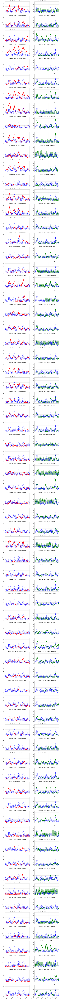

In [22]:
plot_proportion_above_below()

In [23]:
export_charts_above_below()

C:\Users\hcurtis\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


C:\Users\hcurtis\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


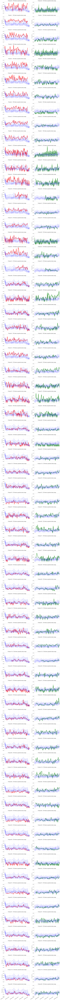

In [24]:
plot_proportion_above_below(testcode="TSH", sort_measure="proportion_above", sort_method="max", sort_period=12, 
                            min_tests_pm=20)

In [25]:
export_charts_above_below(testcode="TSH", sort_measure="proportion_above", sort_method="max", sort_period=12, 
                          min_tests_pm=20)

C:\Users\hcurtis\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


C:\Users\hcurtis\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


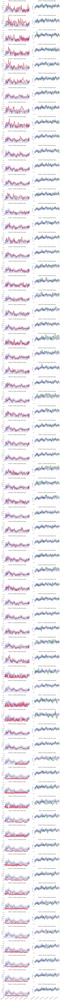

In [26]:
plot_proportion_above_below(testcode="HB", sort_measure= "proportion_above", sort_method= "max", sort_period= 12, 
                            min_tests_pm=20)

In [27]:
export_charts_above_below(testcode="HB", sort_measure= "proportion_above", sort_method= "max", sort_period= 12, 
                            min_tests_pm=20)

C:\Users\hcurtis\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


## Plot above/below both on one chart for each practice

In [28]:
def plot_proportion_above_below_together(datalab_testcode="K"):

    data = proportion_above_below()
    if len(data.index) == 0:
        return "Check test code; may not exist or have no ref values"
    
    # count number of practices in order to set the required number of subplots
    no_figs = np.int(data.practice_id.nunique()/2+data.practice_id.nunique()%2/2)

    fig, axs = plt.subplots(no_figs, 2, figsize = (16,50), facecolor='w')
    fig.subplots_adjust(hspace = .25, wspace=.2)

    for ax, practice in zip(axs.ravel(), data["practice_id"].unique()):
        ax.set_title("Practice "+str(practice)+" - Potassium tests: above and below range", size=14)
        practice = data[(data['practice_id'] == practice)].set_index(["month","practice_id","datalab_testcode","measure"])["measure_value"].unstack().reset_index()
        #ax.plot(practice['month'], practice[measure], color, linewidth=3)
        for measure, c in zip(data["measure"].unique(),["r","g"]):
            #measure = "proportion_above"
            ax.plot(practice['month'], practice[measure], c, linewidth=3, label=measure.replace("_"," "))
            ax.fill_between(practice['month'], practice[measure]-practice[measure+"_error"], practice[measure]+practice[measure+'_error'], color=c, alpha=0.2)
        ax.set_ylabel("Proportion")    
        ax.set_ylim(0,data["measure_value"].max()*1.02)
        ax.set_xlim(data["month"].min(),data["month"].max())
        ax.legend(loc="upper left")

    return fig


C:\Users\hcurtis\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


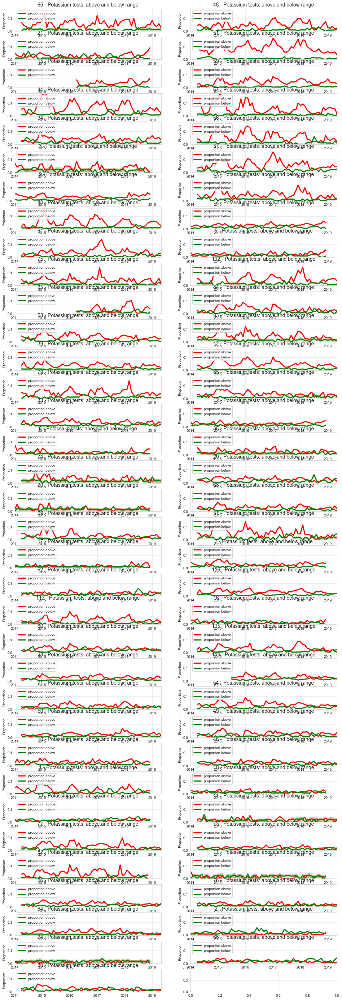

In [29]:

plot_proportion_above_below_together()

In [ ]:
###################################################################################


# Tests outside range: Potassium, CRP, Hb, TSH, ALT


In [ ]:
r2 = df1.copy()

r2 = r2.groupby(["month", "practice_id", "datalab_testcode","outside"])["count"].sum().unstack().fillna(0)

# remove very low test volumes
r2 = r2.loc[r2[0]>20]

r2["measure_value"] = r2[1]/(r2[0]+r2[1])
r2 = r2.drop([0,1],axis=1).unstack().reset_index(col_level=1)
r2.columns = r2.columns.droplevel()
r2

datalab_testcode,month,practice_id,ALB,ALKP,ALT,BASO,CA,CL,CREA,EOS,...,APTT,MG,DIG,RETIC,GFR1,PTH,IRO2,TEST,CRP,AST
0,2014-01-01,1,0.056106,0.078397,0.105448,0.040359,0.039735,0.028395,0.209738,0.143498,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2014-01-01,2,0.036424,0.058824,0.119298,0.060060,0.095238,0.054217,0.201220,0.147147,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2014-01-01,3,0.029412,0.082474,0.134021,0.052941,NaN,0.048611,0.209790,0.182353,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2014-01-01,4,0.035955,0.085057,0.136891,0.033808,0.000000,0.036395,0.205575,0.131673,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2014-01-01,5,0.078189,0.137339,0.117371,0.039216,0.049180,0.041063,0.280193,0.120915,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2014-01-01,6,0.045775,0.070111,0.115242,0.044510,0.185185,0.058989,0.233146,0.119403,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2014-01-01,7,0.030769,0.060870,0.107018,0.036082,0.103448,0.051437,0.196049,0.125430,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2014-01-01,8,0.030973,0.055556,0.088372,0.052419,0.115385,0.048276,0.243986,0.108871,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2014-01-01,9,0.044990,0.069767,0.118896,0.043741,0.080000,0.059468,0.237795,0.134644,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2014-01-01,10,0.022140,0.106870,0.096899,0.046610,0.081081,0.071217,0.192771,0.114407,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Plot deciles

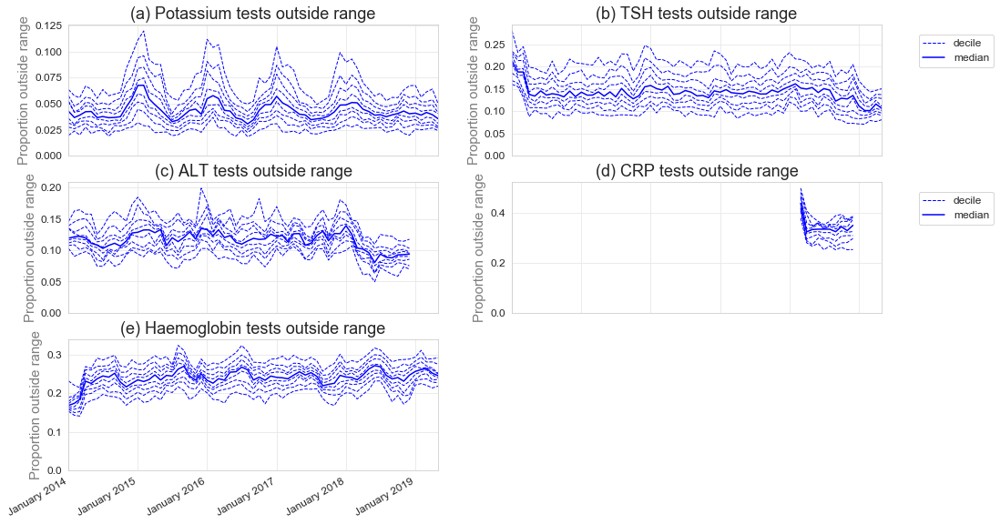

In [35]:
from ebmdatalab import charts
import matplotlib.gridspec as gridspec

import importlib
importlib.reload(charts)

s = [(0,'K',0,0,'(a) Potassium'),
     (1,'TSH',0,1,'(b) TSH'),
     (2,'ALT',1,0,'(c) ALT'),
     (3,'CRP',1,1,'(d) CRP'),
     (4,'HB',2,0,'(e) Haemoglobin')    
    ]

fig = plt.figure(figsize=(16,10)) 


gs = gridspec.GridSpec(3,2)  # grid layout for subplots

# Plot each subplot using a loop
for i in s:
    ax = plt.subplot(gs[i[2], i[3]])  # position of subplot in grid using coordinates listed in s
    plot = charts.deciles_chart(
        r2,
        period_column='month',
        column=i[1],
        title=i[4]+" tests outside range",
        ylabel="Proportion outside range",
        show_outer_percentiles=False,
        show_legend=i[3]==1,
        ax=ax
    )
   
plt.show()


## Plot data for each individual practice for proportion of tests outside range

In [ ]:

def proportion_outside(testcode="K",sort_measure="proportion_outside",sort_method="max",sort_period=12, min_tests_pm=100):
# data to plot
# filter for test of interest:
    data = df1.copy().loc[df1["datalab_testcode"] ==testcode]
    if len(data.index) == 0:
        return data
    
    # group and rearrange data
    data = data.groupby(["month", "practice_id", "datalab_testcode","outside"]).agg({"count":"sum","error":"sum"}).unstack().fillna(0).reset_index()
    # calculate proportions
    data["proportion_outside"] = data[("count",1)]/(data[("count",0)]+data[("count",1)])
    data["proportion_outside_error"] = data[("error",1)]/(data[("count",0)]+data[("count",1)])

    # remove very low test volumes and practices with less than 3 months of data
    data = data.loc[data[("count",0)]>min_tests_pm]
    data = data.set_index("practice_id").loc[data["practice_id"].value_counts() > 6 ].reset_index()

    # rearrange to put measures in columns
    data.columns = [(x + '_' + str(i)).rstrip('_') for x, i in zip(data.columns.get_level_values(0), data.columns.get_level_values(1))]
    data = data.drop(["count_0","error_0","count_1","error_1"], axis=1)
    data = data.set_index(["month","practice_id","datalab_testcode"]).stack().reset_index().rename(columns={"level_3":"measure",0:"measure_value"})

    # sort data - find each practice's highest proportion of tests above-range in last 12 months
    ranks = data.loc[(data["month"] >= data["month"].max()- pd.DateOffset(months=sort_period)) & (data["measure"]==sort_measure)]
    ranks = ranks.groupby(["practice_id"])["measure_value"].agg(sort_method).rank(ascending=False).reset_index().rename(columns={"measure_value":sort_measure+"_rank"})

    # apply sort to data
    data = data.merge(ranks, on = "practice_id").sort_values(by=[sort_measure+"_rank","month"])
    
    return data
    ##############################

    
def plot_proportion_outside(testcode="K",sort_measure="proportion_outside",sort_method="max",sort_period=12, min_tests_pm=100):
    
    data = proportion_outside(testcode=testcode,sort_measure=sort_measure,sort_method=sort_method,sort_period=sort_period, min_tests_pm=min_tests_pm)
    if len(data.index) == 0:
        return "Check test code; may not exist or have no ref values"

    no_figs = np.int(data.practice_id.nunique()/2 + data.practice_id.nunique()%2)

    fig, axs = plt.subplots(no_figs, 2, figsize = (16,50), facecolor='w')
    fig.subplots_adjust(hspace = .25, wspace=.2)
    
    # using a generator, create a combination of each practice and each measure (like a cross-product)
    # this will set the sequence of figures to plot
    a = data["practice_id"].unique()
    b = data["measure"].str.replace("_error","").unique() # don't count error values separately
    gen = ((p, measure) for p in a for measure in b)
    # this will let us plot practice 1, measure 1 alongside practice 1, measure 2  and so on

    for ax, (p, measure) in zip(axs.ravel(), gen):
        color="r"
        ax.set_title("Practice "+str(p)+" - "+testcode+" tests: "+measure.replace("_"," ")+" range", size=14)
        # select and plot data for each practice as a red or green line
        practice = data[(data['practice_id'] == p)].set_index(["month","practice_id","datalab_testcode","measure"])["measure_value"].unstack().reset_index()
        ax.plot(practice['month'], practice[measure], color, linewidth=3)
        ax.fill_between(practice['month'], practice[measure]-practice[measure+"_error"], practice[measure]+practice[measure+'_error'], color=color, alpha=0.4)
        # plot deciles onto every subplot:
        charts.deciles_chart(
            data.loc[data["measure"]==measure],
            period_column='month',
            column="measure_value",
            ylabel="Proportion",
            show_legend=False,
            show_outer_percentiles=False,
            ax=ax)    
        ax.set_ylim(0,data[(data["measure"] == measure)]["measure_value"].max()*1.02)
    
    return fig
    

In [ ]:
plot_proportion_outside()    

### Export to file

In [39]:

def export_charts_outside(testcode="K",sort_measure="proportion_outside", sort_method="max", sort_period=12, min_tests_pm=100):
    data = proportion_outside(testcode=testcode, sort_measure=sort_measure, sort_method=sort_method, sort_period=sort_period, min_tests_pm=min_tests_pm)

    a = data["practice_id"].unique()   
    b = data["measure"].str.replace("_error","").unique() # don't count error values separately
    gen = ((p, measure) for p in a for measure in b)

    fig_no=0

    for (p, measure) in gen:
        fig,ax = plt.subplots()
        fig_no = fig_no+1
        color="r"
        ax.set_title("Practice "+str(p)+" - "+testcode+" tests: "+measure.replace("_"," ")+" range", size=14)
        # select and plot data for each practice as a red or green line
        practice = data[(data['practice_id'] == p)].set_index(["month","practice_id","datalab_testcode","measure"])["measure_value"].unstack().reset_index()
        plt.plot(practice['month'], practice[measure], color, linewidth=3)
        plt.fill_between(practice['month'], practice[measure]-practice[measure+"_error"], practice[measure]+practice[measure+'_error'], color=color, alpha=0.4)
        # plot deciles onto same plot:
        charts.deciles_chart(
            data.loc[data["measure"]==measure],
            period_column='month',
            column="measure_value",
            ylabel="Proportion",
            show_legend=False,
            show_outer_percentiles=False,
            ax=ax)
        ax.set_ylim(0,data[(data["measure"] == measure)]["measure_value"].max()*1.02)
        plt.savefig('/Users/hcurtis/Documents/Python Scripts/openpathology/figures/{}{}_practice{}_{}.png'.format(testcode,measure.replace("_",""),p,fig_no))
        plt.clf()


In [40]:
export_charts_outside()

C:\Users\hcurtis\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
